<a href="https://colab.research.google.com/github/nateandrews/Nathan_Andrews_Project3_Actual/blob/main/AER850_Project_3_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

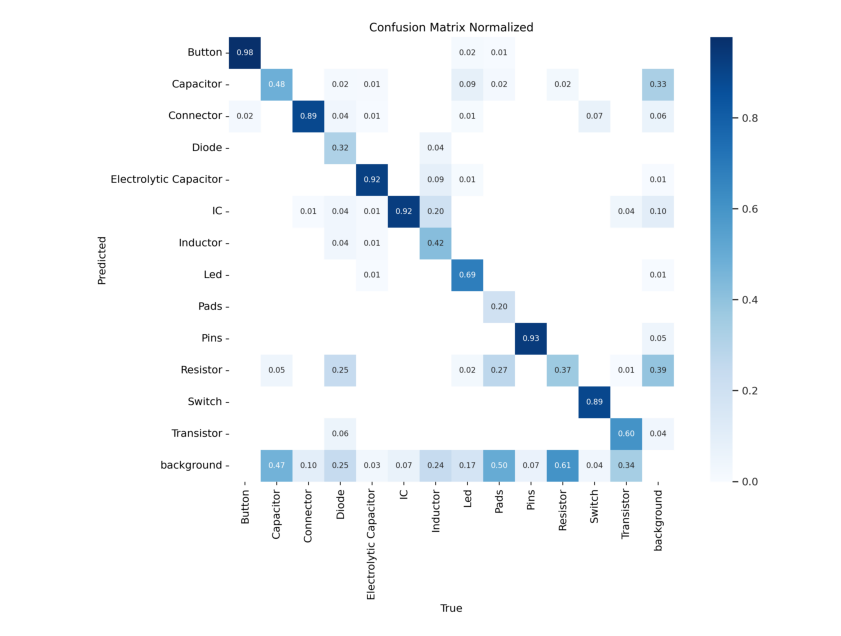

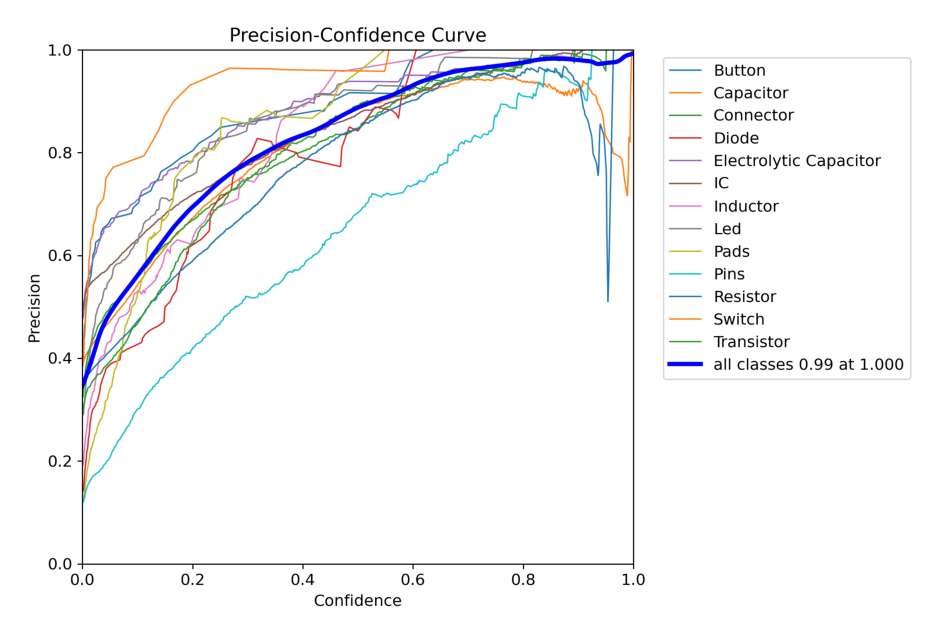

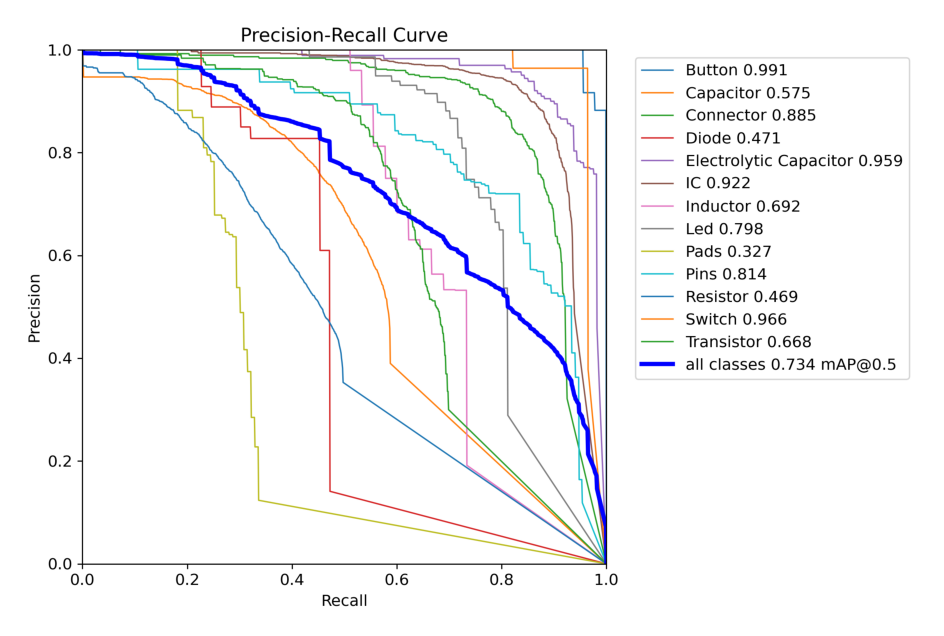


Results for: ardmega.jpg

image 1/1 /content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/evaluation/ardmega.jpg: 928x1024 1 Button, 12 Capacitors, 15 Connectors, 6 ICs, 2 Padss, 19 Resistors, 55.6ms
Speed: 11.3ms preprocess, 55.6ms inference, 2.4ms postprocess per image at shape (1, 3, 928, 1024)


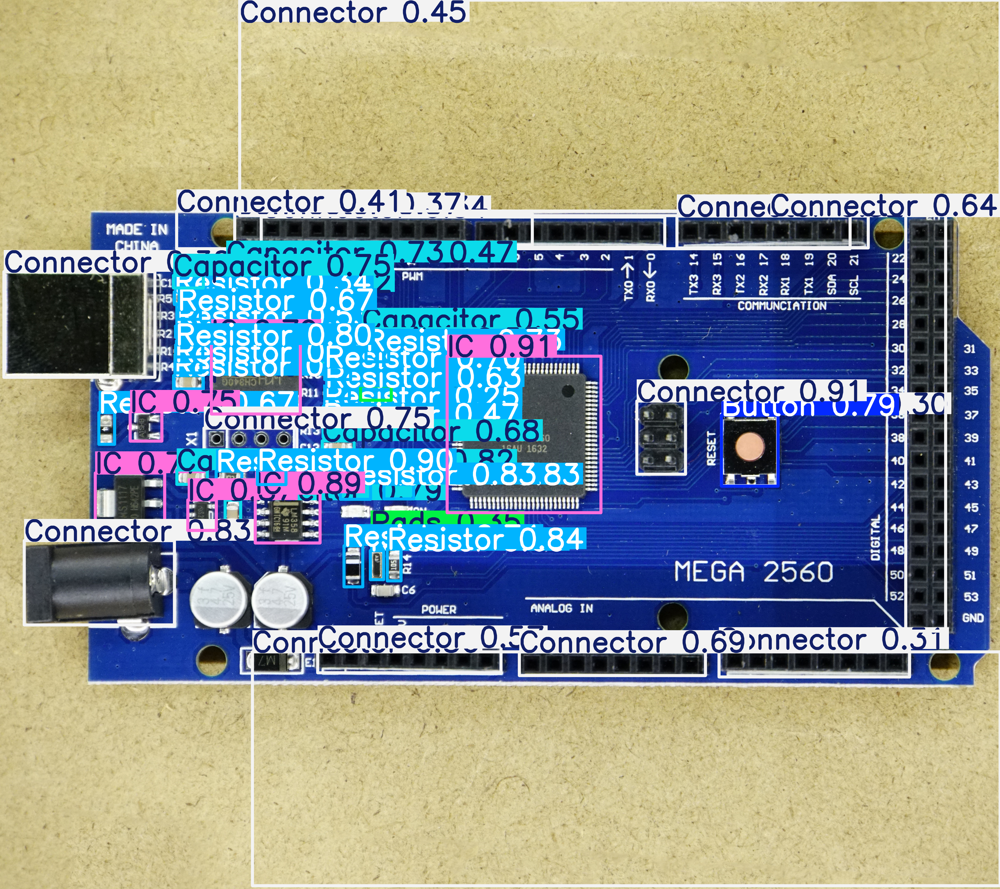


Results for: arduno.jpg

image 1/1 /content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/evaluation/arduno.jpg: 704x1024 1 Button, 11 Capacitors, 7 Connectors, 2 Electrolytic Capacitors, 8 ICs, 3 Leds, 10 Resistors, 53.8ms
Speed: 6.9ms preprocess, 53.8ms inference, 1.9ms postprocess per image at shape (1, 3, 704, 1024)


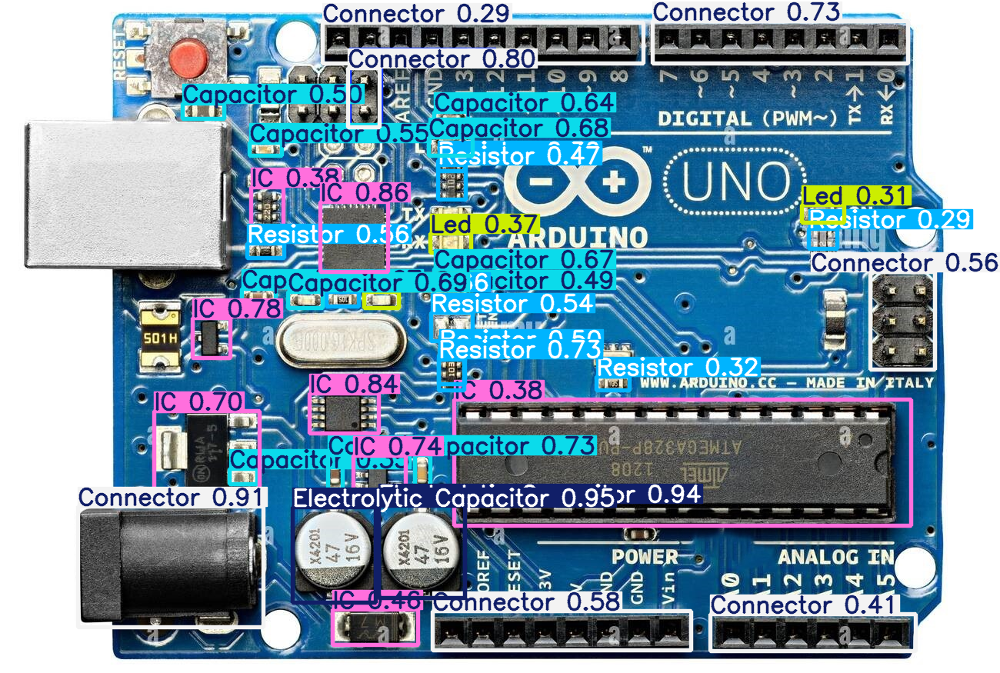


Results for: rasppi.jpg

image 1/1 /content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/evaluation/rasppi.jpg: 704x1024 12 Capacitors, 10 Connectors, 1 Electrolytic Capacitor, 11 ICs, 1 Led, 1 Pads, 17 Resistors, 11.9ms
Speed: 8.4ms preprocess, 11.9ms inference, 1.7ms postprocess per image at shape (1, 3, 704, 1024)
Buffered data was truncated after reaching the output size limit.

In [ ]:
# AER 850 Project 3
# Step 1: Object Masking
import cv2
import numpy as np
from matplotlib import pyplot as plt

path = "/content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/motherboard_image.JPEG"
img_real = cv2.imread(path, cv2.IMREAD_COLOR)
img_real = cv2.rotate(img_real, cv2.ROTATE_90_CLOCKWISE)

img = cv2.imread(path, cv2.IMREAD_COLOR)
img = cv2.GaussianBlur(img, (47,47), 4)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_gray = cv2.adaptiveThreshold(img_gray, 225, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 55, 7)
img_gray = cv2.rotate(img_gray, cv2.ROTATE_90_CLOCKWISE)

edges = cv2.Canny(img_gray,50,300)
edges = cv2.dilate(edges, None, iterations = 10)

contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
mask = np.zeros_like(img_real)
cv2.drawContours(image = mask, contours = [max(contours, key = cv2.contourArea)], contourIdx=-1, color=(255, 255, 255), thickness=cv2.FILLED)
masked_img = cv2.bitwise_and(mask, img_real)

edges_rgb = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
mask_rgb = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)
masked_img_rgb = cv2.cvtColor(masked_img, cv2.COLOR_BGR2RGB)
original_rgb = cv2.cvtColor(img_real, cv2.COLOR_BGR2RGB)

# Plotting
plt.figure(figsize=(20, 5))
plt.subplot(142)
plt.imshow(edges_rgb)
plt.title('Edge Detection Plot')
plt.axis('off')

plt.subplot(143)
plt.imshow(mask_rgb)
plt.title('Mask Plot')
plt.axis('off')

plt.subplot(144)
plt.imshow(masked_img_rgb)
plt.title('Final Extracted PCB Plot')
plt.axis('off')

plt.tight_layout()
plt.show()

!pip install ultralytics

# Step 2: Training YOLOv8
from ultralytics import YOLO

model = YOLO('yolov8n.pt')
results = model.train(data = '/content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/data.yaml', epochs=170, batch=2, imgsz=1024, name='pcb_identifier')

# Step 2.5: Graph and Matrix Curves
import matplotlib.image as mpimg

# Normalized confusion matrix
conf_matrix = mpimg.imread('/content/runs/detect/pcb_identifier/confusion_matrix_normalized.png')
plt.figure(figsize=(12, 8))
plt.imshow(conf_matrix)
plt.axis('off')
plt.show()

# Precision-confidence curve
pc_curve = mpimg.imread('/content/runs/detect/pcb_identifier/P_curve.png')
plt.figure(figsize=(12, 8))
plt.imshow(pc_curve)
plt.axis('off')
plt.show()

# Precision-recall curve
pr_curve = mpimg.imread('/content/runs/detect/pcb_identifier/PR_curve.png')
plt.figure(figsize=(12, 8))
plt.imshow(pr_curve)
plt.axis('off')
plt.show()

# Step 3: YOLOv8 evaluation
from google.colab.patches import cv2_imshow

model = YOLO('/content/runs/detect/pcb_identifier/weights/best.pt')

images1 = ['/content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/evaluation/ardmega.jpg']

for img in images1:
    print(f"\nResults for: {img.split('/')[-1]}")
    results = model.predict(img, imgsz=1024, conf=0.25)
    cv2_imshow(results[0].plot())

model = YOLO('/content/runs/detect/pcb_identifier/weights/best.pt')

images2 = ['/content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/evaluation/arduno.jpg']

for img in images2:
    print(f"\nResults for: {img.split('/')[-1]}")
    results = model.predict(img, imgsz=1024, conf=0.25)
    cv2_imshow(results[0].plot())

model = YOLO('/content/runs/detect/pcb_identifier/weights/best.pt')

images3 = ['/content/drive/MyDrive/AER 850 Project 3 /Nathan_Andrews_Project3_Actual-main/data 2/evaluation/rasppi.jpg']

for img in images3:
    print(f"\nResults for: {img.split('/')[-1]}")
    results = model.predict(img, imgsz=1024, conf=0.25)
    cv2_imshow(results[0].plot())